In [1]:
%pylab inline
import numpy as np
from scipy.io import loadmat

Populating the interactive namespace from numpy and matplotlib


In [2]:
ImPoints = loadmat("data/compEx1data.mat")["x"]

im1_pts = ImPoints[0, 0].T
im2_pts = ImPoints[1, 0].T

im1 = imread("data/kronan1.JPG")
im2 = imread("data/kronan2.JPG")

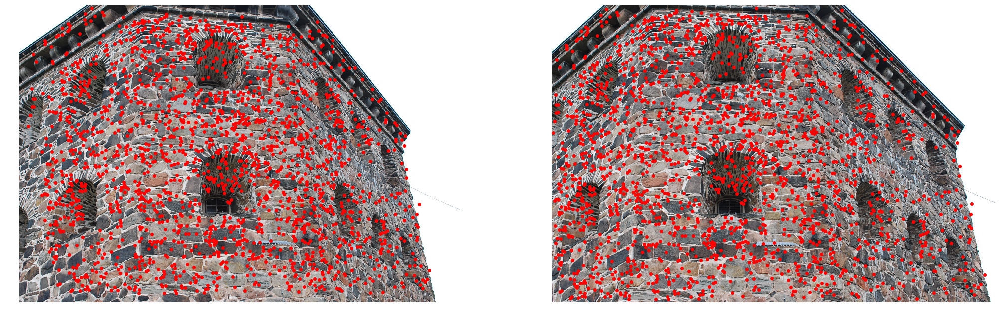

In [3]:
f, axs = plt.subplots(1, 2)
f.set_size_inches(35, 20)
axs[0].axis('off')
axs[1].axis('off')

axs[0].imshow(im1)
axs[0].scatter(im1_pts[:, 0], im1_pts[:, 1], c='r')

axs[1].imshow(im2)
axs[1].scatter(im2_pts[:, 0], im2_pts[:, 1], c='r')

# Task 1 - compute fundamental matrix

In [36]:
def compute_fundamental(pts1, pts2):
    x, xp = pts1[:, 0, None], pts2[:, 0, None]
    y, yp = pts1[:, 1, None], pts2[:, 1, None]
    o = np.ones((pts1.shape[0], 1))
    
    A = np.concatenate((xp*x, xp*y, xp, yp*x, yp*y, yp, x, y, o), axis=1)
    U, S, V = np.linalg.svd(A)
    F_r3 = V[-1, :].reshape((3, 3))
    
    #compute rank 2 matrix
    FU, FS, FV = np.linalg.svd(F_r3)
    FS[-1] = 0.0
    F_r2 = np.dot(FU * FS, FV)

    return F_r2 

In [37]:
F1 = compute_fundamental(im1_pts, im2_pts)
print " mean x'^T . F1 . x = ", einsum('ij,ij->i', im2_pts, F1.dot(im1_pts.T).T).mean()
F1

 mean x'^T . F1 . x =  -0.0062088481352


array([[  3.15474978e-08,   3.84273058e-06,  -5.82716355e-03],
       [ -4.78616557e-06,  -2.81528212e-07,   2.65314253e-02],
       [  7.23129307e-03,  -2.61348603e-02,  -9.99263131e-01]])

In [38]:
F2 = compute_fundamental(im2_pts, im1_pts)
print " mean x'^T . F . x = ", einsum('ij,ij->i', im1_pts, F2.dot(im2_pts.T).T).mean()
F2

 mean x'^T . F . x =  -0.00620884813465


array([[  3.15474978e-08,  -4.78616557e-06,   7.23129307e-03],
       [  3.84273058e-06,  -2.81528212e-07,  -2.61348603e-02],
       [ -5.82716355e-03,   2.65314253e-02,  -9.99263131e-01]])

# Task 2 - plot epipolar lines

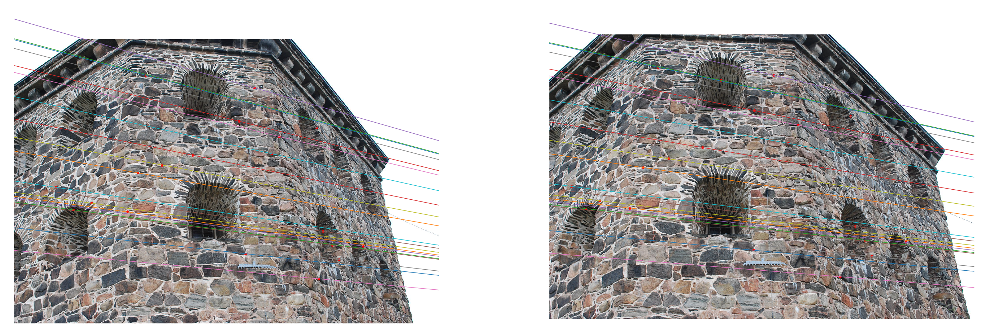

In [43]:
F1 = compute_fundamental(im1_pts, im2_pts)
F2 = compute_fundamental(im2_pts, im1_pts)

choice = np.random.choice(np.arange(im1_pts.shape[0]), 20)
im1_random = im1_pts[choice]
im2_random = im2_pts[choice]

def plot_epipolar_lines(im1_pts, im2_pts, im1, im2, F1, F2):
    f, axs = plt.subplots(1, 2)
    f.set_size_inches(49, 28)
    axs[0].axis('off')
    axs[1].axis('off')

    axs[0].imshow(im1)
    axs[0].scatter(im1_pts[:, 0], im1_pts[:, 1], c='r')

    axs[1].imshow(im2)
    axs[1].scatter(im2_pts[:, 0], im2_pts[:, 1], c='r')
    lines1 = F1.dot(im1_pts.T).T
    lines2 = F2.dot(im2_pts.T).T

    for l1, l2 in zip(lines1, lines2):
        A, B, C = l2
        Xs = [0, im1.shape[1]]
        Ys = [C / -B, (im1.shape[1] * A + C) / -B]
        axs[0].plot(Xs, Ys)

        A, B, C = l1
        Xs = [0, im2.shape[1]]
        Ys = [C / -B, (im2.shape[1] * A + C) / -B]
        axs[1].plot(Xs, Ys)

plot_epipolar_lines(im1_random, im2_random, im1, im2, F1, F2)

# Task 3 - compute fundamental matrix with normalization

In [28]:
def compute_transfor_normalization_matrix(pts):
    T = np.identity(3)
    mean = np.mean(pts, axis=0)
    std_dev = np.std(pts - mean, axis=0)
    
    SX = np.sqrt(2) / std_dev[0]
    SY = np.sqrt(2) / std_dev[1]
    TX = -mean[0] * SX
    TY = -mean[1] * SY
    
    T[[0, 1], [2, 2]] = TX, TY
    T[[0, 1], [0, 1]] = SX, SY

    return T

def normalize(pts, T):
    return T.dot(pts.T).T

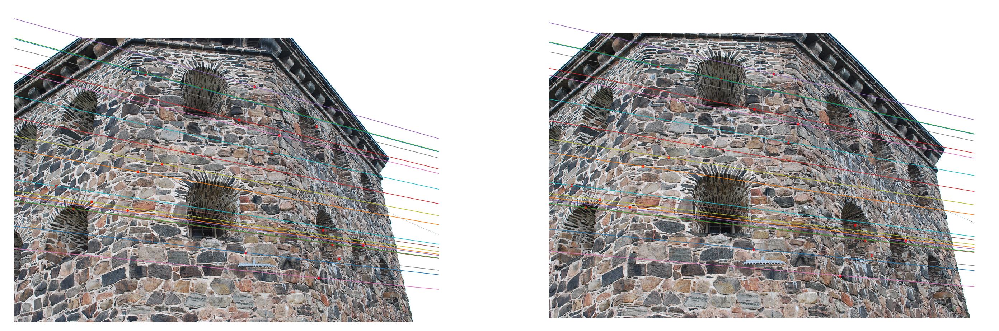

In [45]:
T1 = compute_transfor_normalization_matrix(im1_pts)
T2 = compute_transfor_normalization_matrix(im2_pts)

im1_pts_n = normalize(im1_pts, T1)
im2_pts_n = normalize(im2_pts, T2)

F1_n = compute_fundamental(im1_pts_n, im2_pts_n)
F2_n = compute_fundamental(im2_pts_n, im1_pts_n)

F1_d = T2.T.dot(F1_n).dot(T1)
F2_d = T1.T.dot(F2_n).dot(T2)

# print " mean x'^T . F1_d . x = ", einsum('ij,ij->i', im1_pts, F1_d.dot(im2_pts.T).T).mean()
# print " mean x'^T . F2_d . x = ", einsum('ij,ij->i', im2_pts, F2_d.dot(im1_pts.T).T).mean()


plot_epipolar_lines(im1_random, im2_random, im1, im2, F1_d, F2_d)

# Task 4 - essential matrix

In [30]:
def compute_essential(pts1, pts2):
    x, xp = pts1[:, 0, None], pts2[:, 0, None]
    y, yp = pts1[:, 1, None], pts2[:, 1, None]
    o = np.ones((pts1.shape[0], 1))
    
    A = np.concatenate((xp*x, xp*y, xp, yp*x, yp*y, yp, x, y, o), axis=1)
    U, S, V = np.linalg.svd(A)
    E_r3 = V[-1, :].reshape((3, 3))

    EU, ES, EV = np.linalg.svd(E_r3)
    ES = np.array([((ES[0] + ES[1]) / 2), ((ES[0] + ES[1]) / 2), .0])
    E_r2 = np.dot(EU * ES, EV)

    return E_r2 / E_r2[2, 2] 

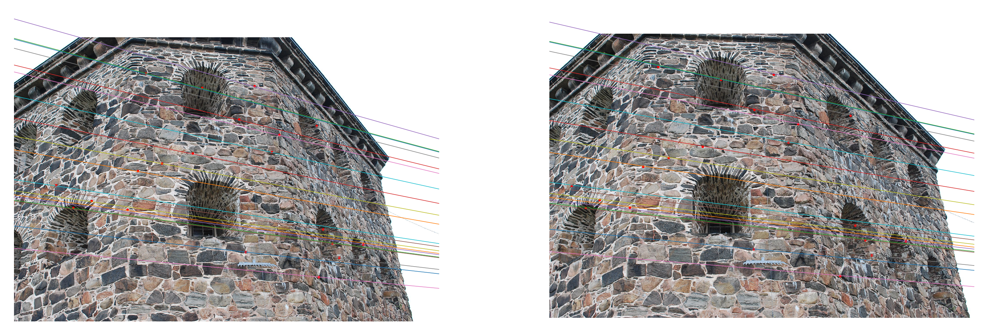

In [46]:
K = loadmat("data/compEx3data.mat")['K']
K_i = np.linalg.inv(K)

im1_pts_k = normalize(im1_pts, K_i)
im2_pts_k = normalize(im2_pts, K_i)

E1 = compute_essential(im1_pts_k, im2_pts_k)
E2 = compute_essential(im2_pts_k, im1_pts_k)

F1_e = K_i.T.dot(E1).dot(K_i)
F2_e = K_i.T.dot(E2).dot(K_i)

# print " mean x'^T @ F1_e @ x = ", einsum('ij,ij->i', im1_pts, F1_e.dot(im2_pts.T).T).mean()
# print " mean x'^T @ F2_e @ x = ", einsum('ij,ij->i', im2_pts, F2_e.dot(im1_pts.T).T).mean()

plot_epipolar_lines(im1_random, im2_random, im1, im2, F1_e, F2_e)